In [18]:
%%time
# Importing the required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime as dt_obj
from scipy import signal
import warnings
warnings.filterwarnings('ignore')

# Function to convert string to date_time object
def to_date(tstr):
    year   = int(tstr[:4])
    month  = int(tstr[5:7])
    day    = int(tstr[8:10])
    hour   = int(tstr[11:13])
    minute = int(tstr[14:16])
    return dt_obj(year, month, day, hour, minute)

# Function to convert into numpy array
def to_array(List):
    l = np.array(List)
    l = l.flatten()
    return l 

# Outlier masking function
def is_outlier(points, thresh=3.5):
    """
    Returns a boolean array with True if points are outliers and False 
    otherwise.

    Parameters:
    -----------
        points : An numobservations by numdimensions array of observations
        thresh : The modified z-score to use as a threshold. Observations with
            a modified z-score (based on the median absolute deviation) greater
            than this value will be classified as outliers.

    Returns:
    --------
        mask : A numobservations-length boolean array.

    References:
    ----------
        Boris Iglewicz and David Hoaglin (1993), "Volume 16: How to Detect and
        Handle Outliers", The ASQC Basic References in Quality Control:
        Statistical Techniques, Edward F. Mykytka, Ph.D., Editor. 
    """
    if len(points.shape) == 1:
        points = points[:,None]
    median = np.median(points, axis=0)
    diff = np.sum((points - median)**2, axis=-1)
    diff = np.sqrt(diff.astype(float))
    med_abs_deviation = np.median(diff)

    modified_z_score = 0.6745 * diff / med_abs_deviation

    return modified_z_score > thresh

Wall time: 0 ns


In [19]:
%%time
# Importing the dataset
df = pd.read_csv('Robust_Scaled.csv', low_memory=False)

# Drop the unwanted column
df = df.drop(columns = ['Unnamed: 0'])
df

Wall time: 18.9 s


,T_REC,HARPNUM,NOAA_ARS,NOAA_AR,LON_FWT,LAT_FWT,TOTUSJH,TOTPOT,TOTUSJZ,ABSNJZH,...,MEANALP,date_time,Max,Type,Reg,CLASS,class,X_or_M,flare_index,LOOK
0,2010.05.02_00:00:00_TAI,1,11067,11067,-65.205566,24.177683,0.431914,0.173426,0.407741,0.274315,...,-0.230618,2010-05-02 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2010.05.02_00:12:00_TAI,1,11067,11067,-64.984444,24.106541,0.438265,0.177587,0.411025,0.617566,...,-0.364324,2010-05-02 00:12:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2010.05.02_00:24:00_TAI,1,11067,11067,-64.888580,24.135088,0.464960,0.185259,0.431423,0.594062,...,-0.351642,2010-05-02 00:24:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2010.05.02_00:36:00_TAI,1,11067,11067,-64.758209,24.144226,0.474002,0.218677,0.440990,0.475601,...,-0.299244,2010-05-02 00:36:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2010.05.02_00:48:00_TAI,1,11067,11067,-64.534355,24.097631,0.510769,0.256765,0.575643,0.179632,...,-0.182030,2010-05-02 00:48:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2651015,2021.12.30_23:12:00_TAI,7912,12923,12923,37.216583,-28.806856,-0.236217,-0.102187,-0.244133,-0.221606,...,0.253028,2021-12-30 23:12:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2651016,2021.12.30_23:24:00_TAI,7912,12923,12923,37.328621,-28.814804,-0.229918,-0.100139,-0.236267,-0.246687,...,-0.018686,2021-12-30 23:24:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2651017,2021.12.30_23:36:00_TAI,7912,12923,12923,37.393547,-28.820169,-0.221924,-0.097421,-0.225549,-0.204925,...,-0.418455,2021-12-30 23:36:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2651018,2021.12.30_23:48:00_TAI,7912,12923,12923,37.471878,-28.819061,-0.220019,-0.097749,-0.222000,-0.208777,...,-0.362545,2021-12-30 23:48:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [20]:
%%time
# Converting date_time from str to date_time object
date_time = df.iloc[:,0]
date_time = [to_date(i) for i in date_time]
df.loc[:,'date_time'] = date_time

Wall time: 10.1 s


## Plotting Time Series and Spectrogram

In [4]:
%%time
# First we need to identify lost flares caused by positional and nan or inf filtering
# Make a blank list to store the indices of the lost flares
lost_indices = []
# Search the lost flares by loop
for i in range(int(np.max(df['flare_index']))):
    if len(df.loc[df['flare_index'] == i]) < 1:
        lost_indices.append(i)

# Store the indices of the flares which are not lost in a list
indices = np.arange(1, np.max(df['flare_index']) + 1)
indices = [int(i) for i in indices if i not in lost_indices]

Wall time: 2.21 s


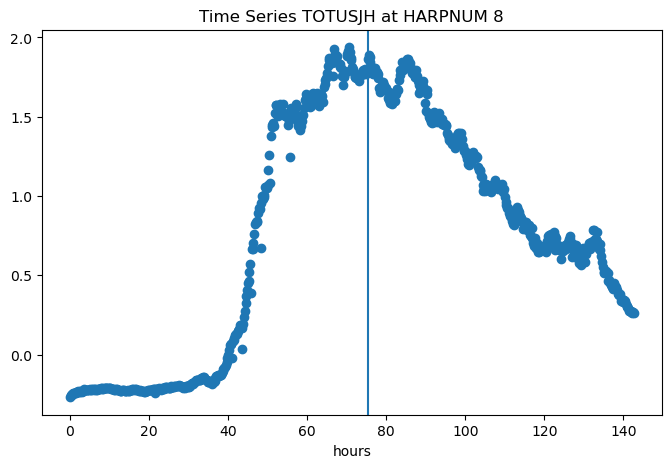

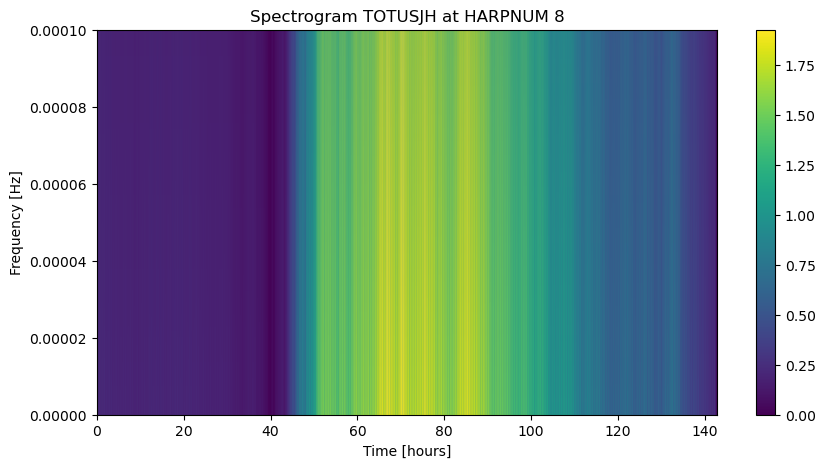

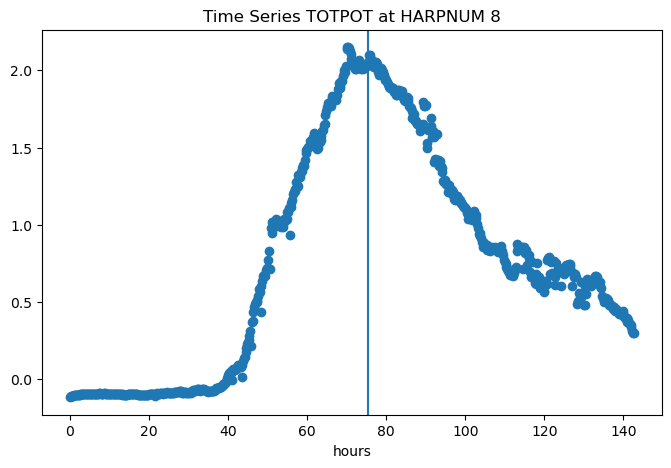

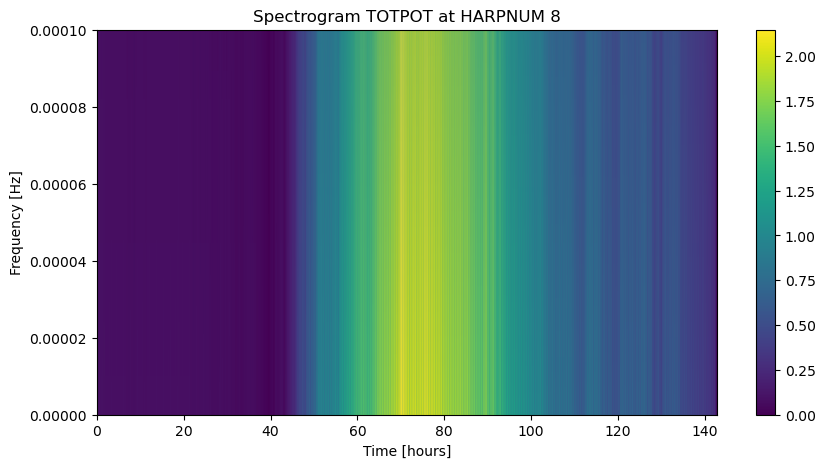

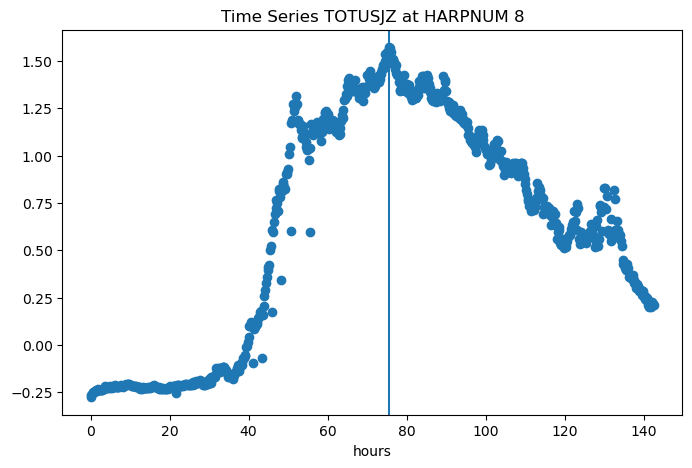

...

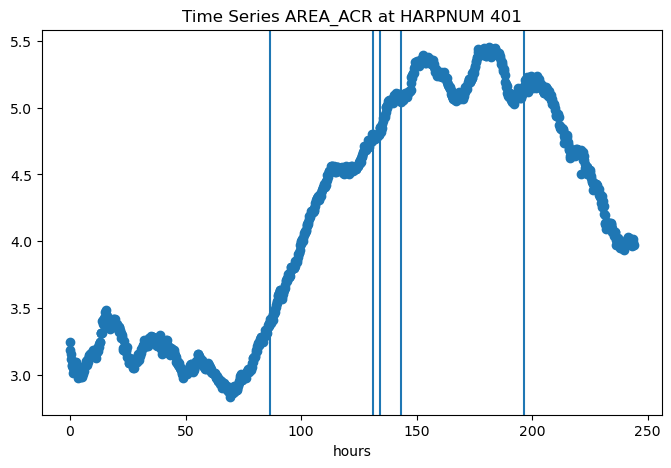

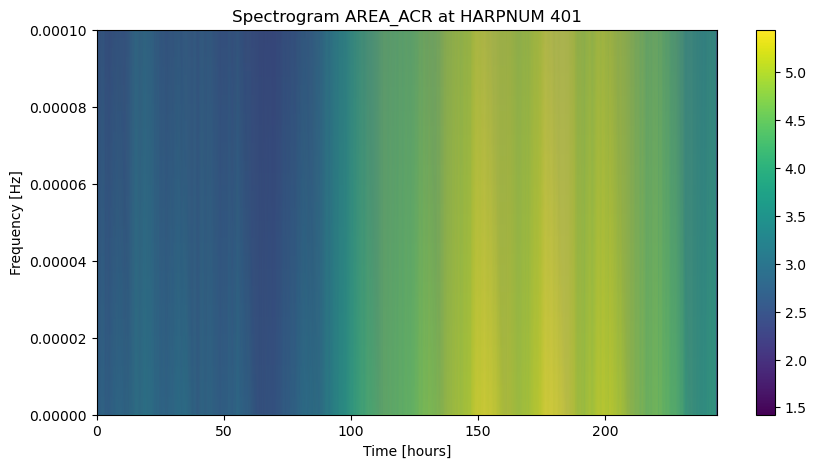

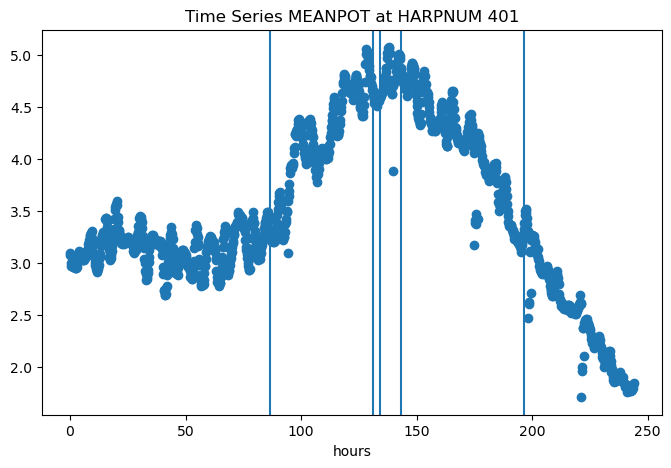

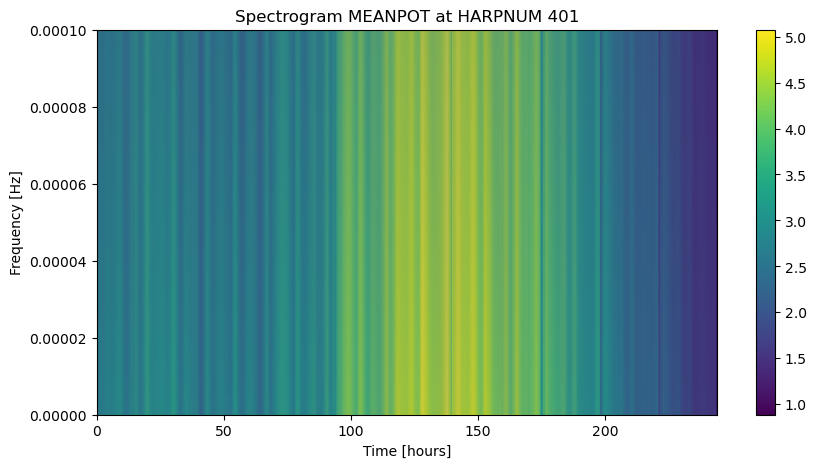

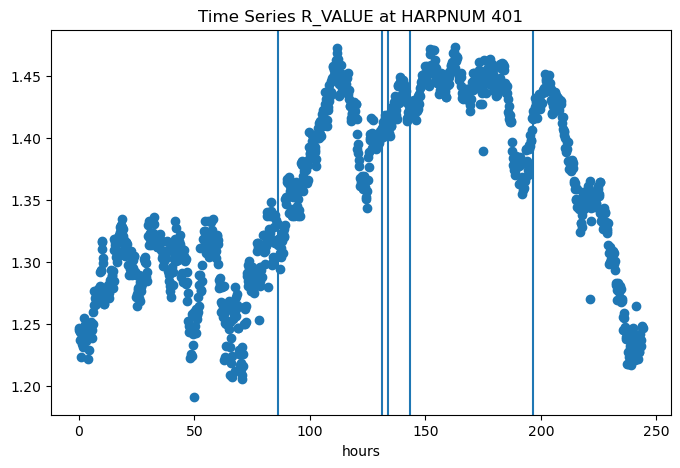

KeyboardInterrupt: 

In [5]:
%%time
# Now we can plot the time series and the spectrogram of the flares 
# Do a loop for each flares
for i in indices:
    # Now do a loop for each parameter
    for col_index in range(6, 24):
        # Get the data for that specific flare
        data = df.loc[df['HARPNUM'] == (df.loc[df['flare_index'] == i].HARPNUM.iloc[0])]
        data['data_index'] = np.arange(0, len(data))
        y = data.iloc[:,col_index]
        x = data[['data_index']]
        flare = data.loc[data['flare_index'] > 0]
        f_x = flare[['data_index']]
        f_y = flare.iloc[:,col_index]
        
        # Plot the time series of that specific flare
        fig, ax = plt.subplots(figsize=(8, 5))
        plt.plot(x*12*60/3600, y, 'o')
        for j in np.array(f_x):
            plt.axvline(x = j*12*60/3600)
        plt.title('Time Series ' + data.columns[col_index] + ' at HARPNUM ' + str(data['HARPNUM'].iloc[0]))
        plt.xlabel('hours')
        plt.show()
        
        # Plot the spectrogram for that specific flare
        f, t, Zxx = signal.stft(y, 1/(12*60), nperseg=3)
        fig, ax = plt.subplots(figsize=(10, 5))
        plt.pcolormesh(t/3600, f, np.abs(Zxx), shading='gouraud')
        plt.title('Spectrogram ' + data.columns[col_index] + ' at HARPNUM ' + str(data['HARPNUM'].iloc[0]))
        plt.ylim(0, 0.0001)
        plt.ylabel('Frequency [Hz]')
        plt.xlabel('Time [hours]')
        plt.colorbar()
        plt.show()

From graphs above, we can conclude that spectral analysis could in fact points out fluctuations in time series

Now we can start investigating which parameters have the stronger fluctuations at flare events. We can determine this by looking at their statistics

In [21]:
%%time
# Find the mean spec value for each parameter
HARPNUM_list = to_array(df['HARPNUM'].drop_duplicates())
# Create blank list to store spec value of each param
param_spec = (np.empty([18, 0])).tolist()

for col_index in range(6, 24):
    for HARPNUM in HARPNUM_list:
        data = to_array(df.loc[df['HARPNUM'] == HARPNUM].iloc[:, col_index])
        f, t, Zxx = signal.stft(data, 1/(12*60), nperseg=3)
        for j in range(len(Zxx[0])):                                                  
            if len(np.abs(Zxx[:,j])) < 2:                                        # We found a small number (~35) of spectrogram which only have one frequency sample so we do this instead
                param_spec[col_index - 6].append(np.abs(Zxx[:,j][0]))
            else:
                param_spec[col_index - 6].append(np.abs(Zxx[:,j][1]))


count = 6
for i in param_spec:
    arr = to_array(i)
    filtered = arr[~is_outlier(arr)]
    print(df.columns[count])
    print('len: ', len(filtered))
    print('avg: ', np.average(filtered))
    print('med: ', np.median(filtered))
    print('std: ', np.std(filtered))
    count += 1

[1.07991828 1.2722686  1.47257936 ... 0.08851083 0.13447046 1.35154307]
TOTUSJH
len:  1022579
avg:  0.11675114107398452
med:  0.10772625043046051
std:  0.08386941006072199
[0.74533377 1.07939133 1.43469568 ... 0.15449255 0.18450611 1.31314683]
TOTPOT
len:  938875
avg:  0.050400290279070545
med:  0.049053749251380445
std:  0.03382174404229178
[0.85137267 0.99333564 1.47137645 ... 0.08984873 0.14970496 1.3097782 ]
TOTUSJZ
len:  1024342
avg:  0.12086758097585584
med:  0.10984495334718473
std:  0.08893805754314507
[2.15542421 2.2141997  2.20772544 ... 0.06639028 0.0611637  1.48844578]
ABSNJZH
len:  991461
avg:  0.1041012551644648
med:  0.09677732275480436
std:  0.06530527207713913
[0.22220536 0.12906881 0.05698445 ... 0.49005557 0.15152278 1.55567485]
SAVNCPP
len:  1042693
avg:  0.14571847048756645
med:  0.1331248343944242
std:  0.09123591296051313
[3.07150015 3.23012636 3.44312946 ... 0.05234825 0.08043995 1.37000161]
USFLUX
len:  1027707
avg:  0.11455690935903547
med:  0.1058992789783263

In [6]:
# Lenght of unfiltered transformed data
len(arr)

1328817

In [7]:
print('R_VALUE')
print('len: ', len(param_spec[8]))
print('avg: ', np.average(param_spec[8]))
print('med: ', np.median(param_spec[8]))
print('std: ', np.std(param_spec[8]))

R_VALUE
len:  1328817
avg:  0.21515988134712527
med:  0.0
std:  0.25340406517057973


In [8]:
%%time
# Find the mean spec value for each parameter in flaring AR
HARPNUM_list = to_array(df.loc[df['flare_index'] > 0].HARPNUM.drop_duplicates())
# Create blank list to store spec value of each param
param_spec_flare = (np.empty([18, 0])).tolist()

for col_index in range(6, 24):
    for HARPNUM in HARPNUM_list:
        data = to_array(df.loc[df['HARPNUM'] == HARPNUM].iloc[:, col_index])
        f, t, Zxx = signal.stft(data, 1/(12*60), nperseg=3)
        for j in range(len(Zxx[0])):
            param_spec_flare[col_index - 6].append(np.abs(Zxx[:,j][1]))
            
count = 6
for i in param_spec_flare:
    print(df.columns[count])
    print('len: ', len(i))
    print('avg: ', np.average(i))
    print('med: ', np.median(i))
    print('std: ', np.std(i))
    count += 1

TOTUSJH
len:  97403
avg:  2.3537196023190257
med:  1.865466027911382
std:  2.0404447718880947
TOTPOT
len:  97403
avg:  3.9273912021405173
med:  2.6028302700877752
std:  4.616265050822205
TOTUSJZ
len:  97403
avg:  2.2479409400025556
med:  1.8282232854079306
std:  1.835742882202642
ABSNJZH
len:  97403
avg:  4.265759217461609
med:  2.2900112341185395
std:  5.659425542149426
SAVNCPP
len:  97403
avg:  3.044961840647546
med:  1.772816573197414
std:  3.642374783749099
USFLUX
len:  97403
avg:  1.9435121908390498
med:  1.580473030087539
std:  1.6024523433531828
AREA_ACR
len:  97403
avg:  1.9614827444878071
med:  1.5634008744434928
std:  1.6514270185580684
MEANPOT
len:  97403
avg:  1.0141371533633672
med:  0.8728184051717158
std:  0.7686979512199686
R_VALUE
len:  97403
avg:  0.5816696091926771
med:  0.6189498907964538
std:  0.15678339234635438
SHRGT45
len:  97403
avg:  0.7103908820786674
med:  0.6736652073793032
std:  0.4515585963696042
MEANSHR
len:  97403
avg:  0.671422206793897
med:  0.6315395

Now we can add spectrogram parameters into the dataset

In [4]:
%%time
# Creating spec dataset
AR = df.loc[df['HARPNUM'] > 0]                                   # First filter the data with numbered HARP only 
AR = AR.sort_values(by=['HARPNUM'])                              # Sort the data on AR
AR['data_index'] = np.arange(1, len(AR) + 1)                     # Then make a new column to add index to each datapoint

# Make a list of HARPNUM
HARPNUM_list = to_array(AR['HARPNUM'].drop_duplicates())
# Create blank lists to store spec value of each param and data index
param_spec = (np.empty([18, 0])).tolist()
data_index = []
# Create a blank dataframe to store the spec correlation and data index
spec = pd.DataFrame(columns=['data_index', 'spec_TOTUSJH', 'spec_TOTPOT', 'spec_TOTUSJZ', 'spec_ABSNJZH', 'spec_SAVNCPP', 'spec_USFLUX',
       'spec_AREA_ACR', 'spec_MEANPOT', 'spec_R_VALUE', 'spec_SHRGT45', 'spec_MEANSHR', 'spec_MEANGAM',
       'spec_MEANGBT', 'spec_MEANGBZ', 'spec_MEANGBH', 'spec_MEANJZH', 'spec_MEANJZD', 'spec_MEANALP',])

# STFT to obtain spec correlation for each param
for col_index in range(6, 24):
    for HARPNUM in HARPNUM_list:
        DATA = AR.loc[AR['HARPNUM'] == HARPNUM]
        data = to_array(AR.loc[AR['HARPNUM'] == HARPNUM].iloc[:, col_index])
        f, t, Zxx = signal.stft(data, 1/(12*60), nperseg=3)
        for j in range(len(Zxx[0])):
            if len(np.abs(Zxx[:,j])) < 2:                                        # We found a small number (~35) of spectrogram which only have one frequency sample so we do this instead
                param_spec[col_index - 6].append(np.abs(Zxx[:,j][0]))
            else:
                param_spec[col_index - 6].append(np.abs(Zxx[:,j][1]))
            if col_index <= 6:
                data_index.append(int(np.rint(t[j] / 720) + np.min(DATA['data_index'])))
                
# Assign the data_index into dataframe for merging
spec.iloc[:,0] = data_index
# Assign the spec correlation of each param into dataframe
for i in range(1, 19):
    spec.iloc[:,i] = param_spec[i-1]

spec.drop(spec.tail(1).index,inplace=True) # drop last row
spec

Wall time: 13min 4s


,data_index,spec_TOTUSJH,spec_TOTPOT,spec_TOTUSJZ,spec_ABSNJZH,spec_SAVNCPP,spec_USFLUX,spec_AREA_ACR,spec_MEANPOT,spec_R_VALUE,spec_SHRGT45,spec_MEANSHR,spec_MEANGAM,spec_MEANGBT,spec_MEANGBZ,spec_MEANGBH,spec_MEANJZH,spec_MEANJZD,spec_MEANALP
0,1,0.205481,0.081677,0.212757,0.140224,0.061002,0.327130,0.373092,0.105966,0.363596,0.071753,0.315126,0.291895,0.696870,0.686968,0.485529,0.161536,0.208680,0.185819
1,3,0.192692,0.076660,0.220489,0.186865,0.162127,0.167095,0.371836,0.011991,0.000000,0.035815,0.035387,0.015955,0.188202,0.167465,0.094591,0.212985,0.067217,0.246156
2,5,0.202131,0.079577,0.228331,0.176705,0.111887,0.170558,0.373834,0.008918,0.000000,0.013664,0.030240,0.009161,0.199613,0.186046,0.105027,0.205703,0.180470,0.234001
3,7,0.211458,0.082040,0.237229,0.297937,0.209723,0.169358,0.362422,0.019767,0.000000,0.043642,0.058050,0.022265,0.228286,0.217532,0.116308,0.290172,0.085539,0.321404
4,9,0.209474,0.081794,0.235801,0.292921,0.230411,0.169470,0.369867,0.022867,0.000000,0.034334,0.044042,0.008884,0.234503,0.222883,0.121805,0.289738,0.124010,0.315210
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328811,2651011,0.129576,0.057865,0.134178,0.084391,0.097032,0.127230,0.155169,0.072495,0.000000,0.235219,0.112309,0.256817,0.413384,0.464560,0.388035,1.428808,3.456400,1.091585
1328812,2651013,0.128641,0.057350,0.133206,0.081149,0.096248,0.126500,0.154746,0.088505,0.000000,0.150121,0.142743,0.214078,0.510332,0.603773,0.297824,1.416836,4.693674,1.129941
1328813,2651015,0.133927,0.058841,0.137451,0.103508,0.134546,0.129850,0.157593,0.065900,0.000000,0.494535,0.630904,1.285038,0.301644,0.383272,0.140132,1.327406,2.815476,1.323716
1328814,2651017,0.126205,0.055647,0.129621,0.112026,0.156190,0.123893,0.153393,0.164408,0.000000,0.387834,0.315290,0.683566,0.442772,0.374041,0.311624,2.126444,3.739967,1.991129


In [5]:
%%time
# Merge the spectogram and SHARP dataset
complete_dataset = pd.merge(AR, spec, on=['data_index'], how="left")
complete_dataset

Wall time: 3.53 s


,T_REC,HARPNUM,NOAA_ARS,NOAA_AR,LON_FWT,LAT_FWT,TOTUSJH,TOTPOT,TOTUSJZ,ABSNJZH,...,spec_R_VALUE,spec_SHRGT45,spec_MEANSHR,spec_MEANGAM,spec_MEANGBT,spec_MEANGBZ,spec_MEANGBH,spec_MEANJZH,spec_MEANJZD,spec_MEANALP
0,2010.05.02_00:00:00_TAI,1,11067,11067,-65.205566,24.177683,0.431914,0.173426,0.407741,0.274315,...,0.363596,0.071753,0.315126,0.291895,0.696870,0.686968,0.485529,0.161536,0.208680,0.185819
1,2010.05.06_02:36:00_TAI,1,11067,11067,-11.296749,24.437330,0.386188,0.150954,0.441300,0.286204,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2010.05.06_02:24:00_TAI,1,11067,11067,-11.390746,24.432217,0.366822,0.143423,0.419162,0.345677,...,0.000000,0.035815,0.035387,0.015955,0.188202,0.167465,0.094591,0.212985,0.067217,0.246156
3,2010.05.06_02:12:00_TAI,1,11067,11067,-11.464979,24.416801,0.401588,0.161598,0.459960,0.396567,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2010.05.06_02:00:00_TAI,1,11067,11067,-11.549165,24.426493,0.405624,0.159411,0.457335,0.353532,...,0.000000,0.013664,0.030240,0.009161,0.199613,0.186046,0.105027,0.205703,0.180470,0.234001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2653239,2021.12.30_19:36:00_TAI,7912,12923,12923,34.538128,-28.941851,-0.274226,-0.119751,-0.280315,-0.236345,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2653240,2021.12.30_19:24:00_TAI,7912,12923,12923,34.414345,-28.956635,-0.275551,-0.121126,-0.284907,-0.236709,...,0.000000,0.387834,0.315290,0.683566,0.442772,0.374041,0.311624,2.126444,3.739967,1.991129
2653241,2021.12.30_23:48:00_TAI,7912,12923,12923,37.471878,-28.819061,-0.220019,-0.097749,-0.222000,-0.208777,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2653242,2021.12.30_21:24:00_TAI,7912,12923,12923,36.186848,-28.818560,-0.246997,-0.107325,-0.260590,-0.186425,...,0.000000,0.314082,0.454034,0.586965,0.402897,0.385181,0.267229,0.606116,1.291985,0.359731


In [7]:
%%time
# Save the dataset
complete_dataset.to_csv('AR_Numbered_with_Spectogram.csv', index=False)

Wall time: 2min 21s
